# Manually Parse ATL06 to for troubleshooting of script  

Error in parser could be due not passing the logger when the function expects one
logging.basicConfig(filename=f'logs_{region}.log', level=logging.INFO, format='%(asctime)s:%(levelname)s:%(message)s')

In [1]:
%matplotlib inline

In [2]:
import os

import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
plt.rcParams.update({'figure.figsize': (15, 8), 'font.size': 10})

from shapely.geometry import Polygon, Point

import contextily as ctx
import h5py

In [3]:
from icesat2_search_and_download_ATL import gps2dyr
from icesat2_search_and_download_ATL import  move_files_from_order, read_atl06, read_atl08, get_api_key


---

In [4]:
# icesat2_path = 'D:/wspace/icesat2/alaska'
# icesat2_path = f'/fs/project/howat.4/yadav.111/icesat2/greenland'
icesat2_path = 'test_data'


In [5]:
# os.listdir(icesat2_path)

In [6]:
# outline = gpd.read_file(f'{icesat2_path}/strip_outline.shp')
outline = gpd.read_file(f'{icesat2_path}/outline.shp')
outline.crs = {'init': 'epsg:4326'} #somehow proj file was missing here (this should not happen in future)
outline

,id,geometry
0,0,"POLYGON ((-147.50000 64.20000, -147.50000 65.2..."


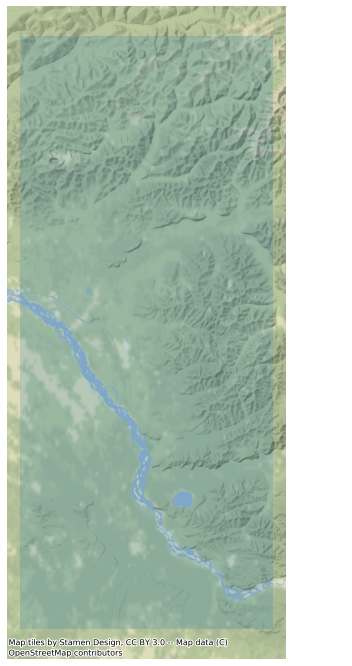

In [7]:
# outline = outline.to_crs(epsg=3857) #convert to web-mercator for visualization
fig, ax = plt.subplots(figsize=(11,12))
# ax = outline.to_crs(epsg=3857).plot(alpha=.5)
outline.to_crs(epsg=3857).plot(alpha=.2, ax=ax) # convert to web-mercator to use contextly
# https://geopandas.org/gallery/plotting_basemap_background.html
# ctx.add_basemap(ax, url=ctx.providers.Stamen.TonerLite)
ctx.add_basemap(ax=ax) # Also provide zoom=12
ax.set_axis_off()

In [8]:
# import geoplot

In [18]:
# def read_atl06(icesat2_path):
""" 
Read 1 ATL06 file and output 6 reduced files. 

Extract variables of interest and separate the ATL06 file 
into each beam (ground track) and ascending/descending orbits.
"""
files = os.listdir(f'{icesat2_path}')
# files
hdf_files = [f for f in files if f.endswith('.h5') and 'ATL06' in f]#[f for f in files if f.endswith('.h5')]
hdf_files

['processed_ATL06_20190813103742_07080403_002_01.h5',
 'processed_ATL06_20190818224838_07920405_002_01.h5',
 'processed_ATL06_20190809104601_06470403_002_01.h5',
 'processed_ATL06_20190822224019_08530405_002_01.h5']

In [19]:
# For testing only
# hdf_files = hdf_files[0]
hdf_files

['processed_ATL06_20190813103742_07080403_002_01.h5',
 'processed_ATL06_20190818224838_07920405_002_01.h5',
 'processed_ATL06_20190809104601_06470403_002_01.h5',
 'processed_ATL06_20190822224019_08530405_002_01.h5']

In [20]:
icesat2_path

'test_data'

In [27]:
hdf_files[0]

'processed_ATL06_20190813103742_07080403_002_01.h5'

In [28]:
# for f in hdf_files[5:6]:
f = hdf_files[0]
hdf_path = f'{icesat2_path}/{f}'
print(f'{hdf_path} {os.path.exists(hdf_path)}')
res_dict = {}
meta_dict = {} #These will hold metadata required for scalars per ground-track
# group = ['gt1l', 'gt1r', 'gt2l', 'gt2r', 'gt3l', 'gt3r']
# group = ['gt2l', 'gt2r', 'gt3l', 'gt3r']
# group = ['gt1l', 'gt1r']
group = ['gt1l', 'gt1r', 'gt2l', 'gt2r', 'gt3l', 'gt3r']
# Loop trough beams
# Perhaps read file first, then loop through groups; should be faster


test_data/processed_ATL06_20190813103742_07080403_002_01.h5 True


In [29]:
fi = h5py.File(hdf_path, 'r')

In [31]:
[g for g in list(fi.keys()) if g in group]

['gt1l', 'gt1r', 'gt2l', 'gt2r', 'gt3l', 'gt3r']

In [ ]:
# subset group based on data
group = [g for g in list(fi.keys()) if g in group]
for k,g in enumerate(group):
    #try:
    print(k, g)
    # 1) Read in data for a single beam #
    lat = fi[f'/{g}/land_ice_segments/latitude'][:]
    lon = fi[f'/{g}/land_ice_segments/longitude'][:]
    h_li = fi[f'/{g}/land_ice_segments/h_li'][:] #nan

In [25]:
qual_str_count = ''
# Loop trough beams
# Perhaps read file first, then loop through groups; should be faster
with h5py.File(hdf_path, 'r') as fi:
    # subset group based on data
    group = [g for g in list(fi.keys()) if g in group]
    for k,g in enumerate(group):
        #try:
        print(k, g)
        # 1) Read in data for a single beam #
        lat = fi[f'/{g}/land_ice_segments/latitude'][:]
        lon = fi[f'/{g}/land_ice_segments/longitude'][:]
        h_li = fi[f'/{g}/land_ice_segments/h_li'][:] #nan
        #s_li = fi[f'/{g}/land_ice_segments/h_li_sigma'][:] #nan
        t_dt = fi[f'/{g}/land_ice_segments/delta_time'][:]
        q_flag = fi[f'/{g}/land_ice_segments/atl06_quality_summary'][:]
        t_ref = fi['/ancillary_data/atlas_sdp_gps_epoch'][:] #scalar 1 value; required for offset
        #rgt = fi['/orbit_info/rgt'][:] * np.ones(len(lat)) #scalar 1 value
        #orb = np.full_like(h_li, k) #scalar 1 value

        meta_dict['t_ref'] = t_ref #dictionary of metadata (will be used in future to investigate data)
        # 2) Make Pandas dataframe
        #t_dt = gps2dyr(t_dt, offset=t_ref) #time consuming 
        df = pd.DataFrame({'lon':lon, 'lat':lat, 'h_li': h_li, 'q_flag':q_flag, 't_dt':t_dt})
        #Convert GPS time to actual time using function
        df['t_dt'] = df['t_dt'].apply(gps2dyr, offset=t_ref[0])
        #df['fname'] = f.split('.')[0] #to save hdf filename; could important when multiple hdf files over a rema tile
        #df.index = df.t_dt #creates difficultly in plotting
        # Fill Nans for na-data and drop
        df.loc[df.h_li>3e38, 'h_li'] = np.nan
        df = df.dropna()
        all_points = len(df)
        #df = df[df.q_flag==0] #select only flags of zero (good values) can be empty sometimes
        good_quality_points = len(df) #len(df[df.q_flag==0])
        qual_str_count = qual_str_count + f'{g}={good_quality_points}/{all_points}; '
        if len(df)>0:
            # Assemble ground track into a dictionary, later we convert to csv and shp through df
            res_dict[g] = df
#         except:
#             # Most like this error is due to empty dataframe 
#             # may not exist anymore since we are no dropping the bad quality data
#             print(f'\tException in reading hdf group (ground track), df length = {len(df)}')

0 gt1l
1 gt1r
2 gt2l
3 gt2r
4 gt3l
5 gt3r


In [26]:
df

,lon,lat,h_li,q_flag,t_dt
1,-146.500072,64.890848,309.118530,1,2019-08-18 22:53:15.734
3,-146.500170,64.890491,312.450775,1,2019-08-18 22:53:15.740
4,-146.500217,64.890313,313.711670,1,2019-08-18 22:53:15.742
7,-146.500363,64.889778,318.288147,1,2019-08-18 22:53:15.751
9,-146.500456,64.889421,328.994507,1,2019-08-18 22:53:15.756
...,...,...,...,...,...
2299,-146.673744,64.200851,358.842041,1,2019-08-18 22:53:26.629
2300,-146.673786,64.200672,356.518951,0,2019-08-18 22:53:26.632
2301,-146.673827,64.200494,356.645996,0,2019-08-18 22:53:26.635
2302,-146.673868,64.200315,357.059998,0,2019-08-18 22:53:26.638


In [13]:
#----------------------------------------------------------------------------------------------
# Now that ATL06 data from separate ground tracks are in one dict, merge it to df and save to csv/shp
if len(res_dict)>0:
    print(f'\tGood/Total Points: {qual_str_count}   Total GTs = {len(res_dict)}')
    # To guard againt empty result dictionary created with no icesat2 passing the quality control above
    # 1. Combine Dataframes for each of 6 ground-tracks into single Dataframe
    count = 0
    for k in res_dict.keys():
        # k = 'gt1l', 'gt1r' etc
        if count == 0:
            df = res_dict[k]
            df['strip'] = k
            count += 1
        else:
            df1 = res_dict[k]
            df1['strip'] = k
            df = pd.concat([df, df1], axis=0)
    # Log the time range of icesat2 data (could be useful for understanding why some data is large)
    # This may be creating exception when empty
    time_range = df.t_dt.max() - df.t_dt.min()
    print(f"\tRows = {len(df)} \t Time Range = {time_range.total_seconds()} seconds")
    # Choose filename for csv and shapefile
    atl_fname = os.path.splitext(hdf_path)[0].split('/')[-1]
    #df = df[df.q_flag==0] # Already done above for each ground track
    #df.to_csv(f'{icesat2_path}/{atl_fname}.csv', index=False)

    # 2. Convert to Geopandas
    df['coord'] = df[['lon', 'lat']].apply(lambda x: Point(x), axis=1)
    gdf = gpd.GeoDataFrame(df[['t_dt', 'h_li', 'q_flag', 'strip', 'coord']], geometry='coord')
    gdf['t_dt'] = gdf['t_dt'].dt.strftime('%Y-%m-%d %H:%M:%S.%f') #To prevent DriverSupportError: ESRI Shapefile does not support datetime fields
    gdf.crs = {'init': 'epsg:4326'} #not yet verified or checked with what ICESAT-2 metadata provides
    #gdf.to_file(f'{icesat2_path}/{atl_fname}.shp')
    # perhaps even return df or gdf 
    #return gdf
else:
    logging.info(f"\tNo good quality Ground Track in this HDF file; csv or shp not created")

	Good/Total Points: gt1l=65152/65152; gt1r=64862/64862; gt2l=64646/64646; gt2r=64019/64019; gt3l=64847/64847; gt3r=64525/64525;    Total GTs = 6
	Rows = 388051 	 Time Range = 186.858 seconds


In [16]:
len(gdf)

388051

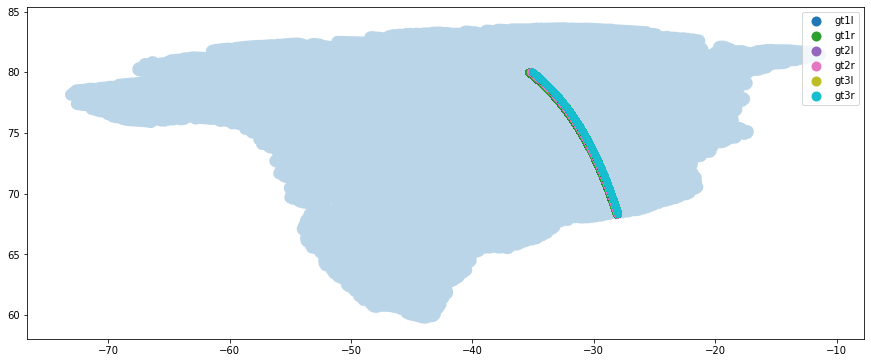

In [17]:
ax = outline.plot(alpha=.3)
gdf.plot(column='strip', legend=True, ax=ax);

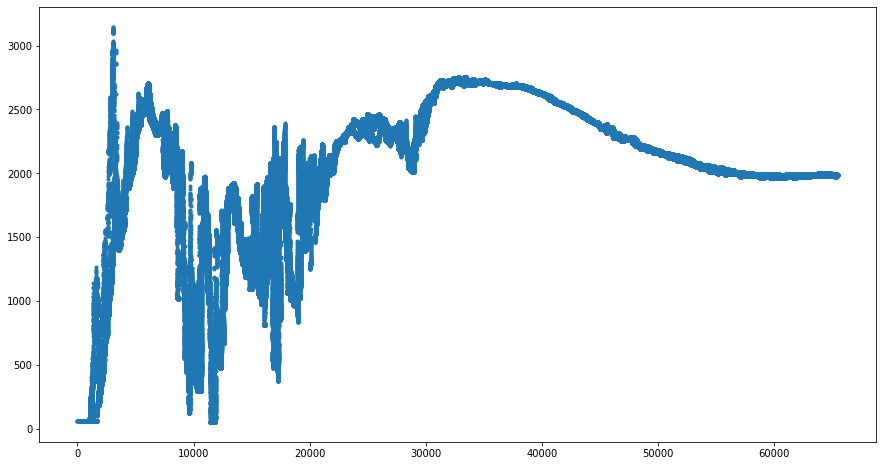

In [20]:
df.h_li.plot(style='.');

In [22]:
import hvplot
import hvplot.pandas
import geoviews as gv

In [23]:
df.head(2)

,lon,lat,h_li,q_flag,t_dt,strip,coord
0,-28.116204,68.276123,57.885662,1,2019-08-01 03:14:09.495,gt1l,POINT (-28.11620393362371 68.27612256021547)
1,-28.116259,68.276301,57.887543,0,2019-08-01 03:14:09.498,gt1l,POINT (-28.1162593737522 68.27630084456911)


In [24]:
df.hvplot(y='h_li', x='t_dt', by='strip', kind='scatter')

:NdOverlay   [strip]
   :Scatter   [t_dt]   (h_li)

In [22]:
# gv.tile_sources.StamenTerrainRetina 
(gv.tile_sources.ESRI  * df.hvplot.points('lon', 'lat', geo=True, color='strip', alpha=0.6, width=500, height=800, hover=['strip', 'h_li']) + 
 df.hvplot(y='lat', x='h_canopy', by='q_flag', kind='scatter', height=800, alpha=.7)).cols(2)

:Layout
   .Overlay.I   :Overlay
      .WMTS.I   :WMTS   [Longitude,Latitude]
      .Points.I :Points   [lon,lat]   (strip)
   .NdOverlay.I :NdOverlay   [q_flag]
      :Scatter   [h_canopy]   (lat)

In [23]:
(gv.tile_sources.ESRI  * df.hvplot.points('lon', 'lat', geo=True, color='strip', alpha=0.6, width=500, height=800, hover=['strip', 'h_li']) + 
 df.hvplot(y='lat', x='h_li', by='q_flag', kind='scatter', height=800, alpha=.7)).cols(2)

:Layout
   .Overlay.I   :Overlay
      .WMTS.I   :WMTS   [Longitude,Latitude]
      .Points.I :Points   [lon,lat]   (strip)
   .NdOverlay.I :NdOverlay   [q_flag]
      :Scatter   [h_li]   (lat)

In [24]:
# outline.plot()

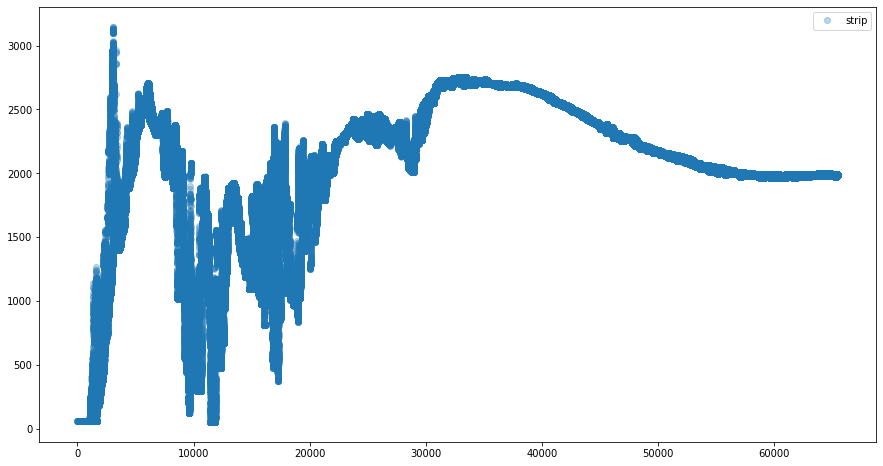

In [26]:
df.h_li.plot(style='o', label='strip', alpha=.3)
plt.legend(loc=0)

In [27]:
import holoviews as hv

In [28]:
points = hv.Points(np.random.randn(500,2))
points.hist(num_bins=51, dimension=['x','y'])

:AdjointLayout
   :Points   [x,y]
   :Histogram   [y]   (y_frequency)
   :Histogram   [x]   (x_frequency)

In [29]:
t_diff = df.t_dt.max() - df.t_dt.min()
t_diff

Timedelta('0 days 00:03:06.858000')

In [30]:
# How many minutes worth of data in the granule
t_diff.total_seconds()/60

3.1143

In [31]:
# df.to_csv('C:/temp/del.csv', index=False)

In [32]:
shp_files = [f for f in files if f.endswith('.shp') and 'ATL06' in f]
shp_files

['processed_ATL06_20190801044531_05210403_002_01.shp']

In [33]:
shp1 = f'{icesat2_path}/{shp_files[0]}'

In [34]:
gdf = gpd.read_file(shp1)

In [35]:
gdf['t_dt'] = pd.to_datetime(gdf.t_dt)

In [36]:
gdf.head()

,t_dt,h_li,q_flag,strip,geometry
0,2019-08-01 04:46:49.378,29.104633,1,gt1l,POINT (-50.06900 62.10511)
1,2019-08-01 04:46:49.381,29.195328,0,gt1l,POINT (-50.06904 62.10529)
2,2019-08-01 04:46:49.384,29.187654,0,gt1l,POINT (-50.06908 62.10547)
3,2019-08-01 04:46:49.392,29.502611,1,gt1l,POINT (-50.06921 62.10600)
4,2019-08-01 04:46:49.395,28.908991,1,gt1l,POINT (-50.06925 62.10618)


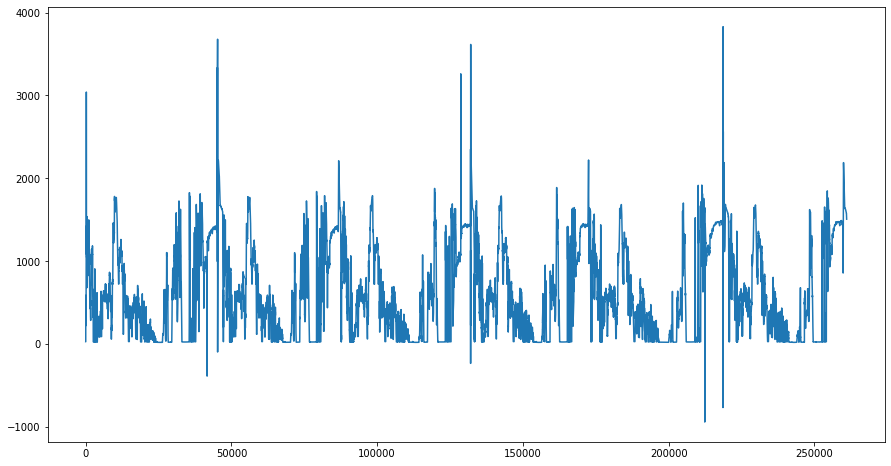

In [37]:
gdf[gdf.q_flag==0].h_li.plot()
# gdf[gdf.q_flag==1].h_li.plot(style='o')

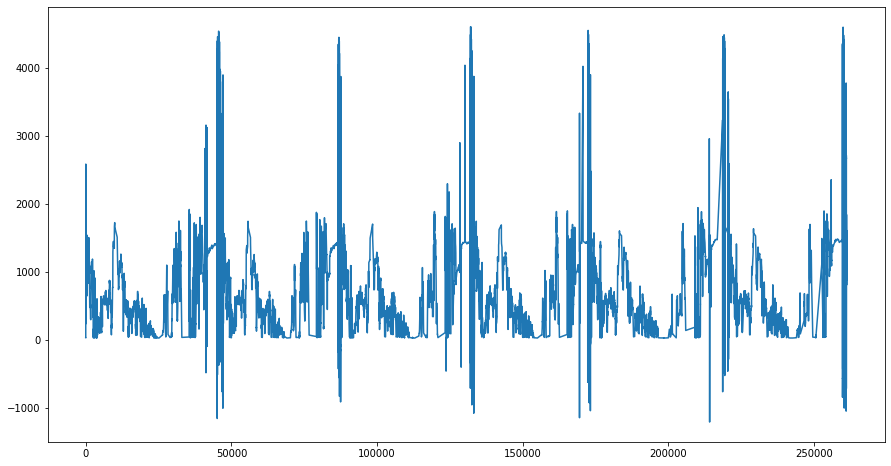

In [39]:
gdf[gdf.q_flag==1].h_li.plot();

In [40]:
df

,lon,lat,h_li,q_flag,t_dt,strip,coord
0,-28.116204,68.276123,57.885662,1,2019-08-01 03:14:09.495,gt1l,POINT (-28.11620393362371 68.27612256021547)
1,-28.116259,68.276301,57.887543,0,2019-08-01 03:14:09.498,gt1l,POINT (-28.1162593737522 68.27630084456911)
2,-28.116315,68.276479,58.061340,0,2019-08-01 03:14:09.501,gt1l,POINT (-28.11631501771 68.27647912005973)
3,-28.116371,68.276657,58.264893,0,2019-08-01 03:14:09.504,gt1l,POINT (-28.11637104271906 68.2766573780788)
4,-28.116428,68.276836,58.463898,0,2019-08-01 03:14:09.507,gt1l,POINT (-28.11642752548583 68.27683561585312)
...,...,...,...,...,...,...,...
65349,-35.018732,80.005210,1972.523315,0,2019-08-01 03:17:16.230,gt3r,POINT (-35.01873237253757 80.00521001486885)
65350,-35.018947,80.005385,1972.482300,0,2019-08-01 03:17:16.233,gt3r,POINT (-35.01894673835734 80.00538528195047)
65351,-35.019161,80.005561,1972.453369,0,2019-08-01 03:17:16.236,gt3r,POINT (-35.01916142411581 80.00556054136572)
65352,-35.019377,80.005736,1972.447021,0,2019-08-01 03:17:16.239,gt3r,POINT (-35.01937651146752 80.00573578741002)


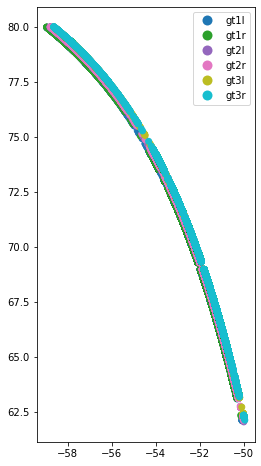

In [41]:
# js = gdf.to_json()
gdf.plot(column='strip', legend=True);